In [21]:
%matplotlib inline


from keras.models import Model, load_model
from keras import backend as K
from keras.callbacks import TensorBoard, EarlyStopping
from keras.layers import LSTM, Dropout, Dense, BatchNormalization, Activation, Input, TimeDistributed
from keras.regularizers import l2
from keras.layers.advanced_activations import LeakyReLU, ELU, PReLU
from keras.optimizers import RMSprop, Adam, Adadelta, Adagrad
from keras.utils import to_categorical
import numpy as np
from time import time
from matplotlib import pyplot as plt

from assignment.helpers import datapreparation as prep


fs1_dirpath = "./assignment/datasets/training/piano_roll_fs1"


# Load initial data
datasets = prep.load_all_dataset(fs1_dirpath)
dataset_names = prep.load_all_dataset_names(fs1_dirpath)
unique_names = set()
for name in dataset_names: # Make sure the same names get the same encoding each run
    unique_names.add(name)
unique_names = list(unique_names)
name_to_int = dict([(unique_names[i], i) for i in range(len(unique_names))])
int_to_name = dict([(i, unique_names[i]) for i in range(len(unique_names))])
dataset_names = to_categorical([name_to_int[name] for name in dataset_names]) # one-hot encode the composers
datasets = [dataset[:, 1:] for dataset in datasets] # Remove the headers

# Setting initial parameters
dataset_id_names = dict(zip(np.arange(len(dataset_names)), dataset_names))
longest_song = max(datasets[i].shape[1] for i in range(len(datasets)))
sequence_length = 8
length = longest_song//sequence_length + 1
num_keys = len(datasets[0])
parts_per_song = int(longest_song/sequence_length)
composer_encoding_len=len(dataset_names[0]) # 4 composers

# Makes several datasets from this first one with differing intervals between to capture the "gaps" between two sequences
# Add each subsequence of each song with differing offsets ([0:10], [1:11], [2:12], ...) to retain information.
# Unable to implement stateful, so try to retain as much information between subsequences as possible. 
# Also a way of dataset augmentation (regularization) by increasing the size of the dataset

def transpose_and_label_more(dataset_names, datasets, num_keys):
    zs = []
    datasets_transposed = np.array([(datasets[i].T, dataset_names[i]) for i in range(len(datasets))])
    for song, composer in datasets_transposed:
        for offset in range(0, sequence_length, 1):
            for i in range(0, len(song)//sequence_length-offset):
                x = song[offset+i*sequence_length:offset+(i+1)*sequence_length]
                if i == len(song)//sequence_length - (1+offset): # Add the EOF marker if last seq of song
                    y = np.append(song[offset+i*sequence_length+1:offset+(i+1)*sequence_length], np.array([np.ones(num_keys)]), 0)
                else:
                    y = song[offset+i*sequence_length+1:offset+(i+1)*sequence_length+1]
                zs.append((x, y, composer))
    np.random.shuffle(zs)
    xs, ys, composers = [], [], []
    for x, y, composer in zs:
        xs.append(x)
        ys.append(y)
        composers.append(composer)
    return np.array(xs), np.array(ys), np.array(composers)

train_xs, train_ys, train_composers = transpose_and_label_more(dataset_names, datasets, num_keys)
test_xs = train_xs[int(len(train_xs)*0.8):]
train_xs = train_xs[:int(len(train_xs)*0.8)]
test_ys = train_ys[int(len(train_ys)*0.8):]
train_ys = train_ys[:int(len(train_ys)*0.8)]
test_composers = train_composers[int(len(train_composers)*0.8):]
train_composers = train_composers[:int(len(train_composers)*0.8)]

In [2]:
inputs = Input(shape=(sequence_length, num_keys))

# Units = units per timestep LSTM block, i.e. output dimensionality (128 here since input and output 128 keys)
lstm1 = LSTM(num_keys,
               activation='relu',
               return_sequences=True,
               name="lstm1")(inputs)

# Form of regularization, and helps by normalizing over each minibatch.
# Tansformation that maintains the mean activation close to 0 and the activation standard deviation close to 1.
normalized1 = BatchNormalization()(lstm1)
dense1 = Dense(num_keys, activation="relu", name="dense1")(normalized1)

lstm2 = LSTM(num_keys,
               activation='relu',
               return_sequences=True, name="lstm2")(dense1)

normalized2 = BatchNormalization()(lstm2)
outputs = TimeDistributed(Dense(num_keys, activation="sigmoid", name="outputs"))(normalized2) # Sigmoid keeps the probabilities independent of each other, while softmax does not!

model = Model(inputs, outputs)

adam = Adam(lr=0.001, amsgrad=True)
# Ends up in a point where gradients really small, denominator really small and then loss exploding
# v_t is based on the gradients at the current time step, and previous v_t, thus when gradient really small as well as v_t-1
# the update denominator (sqrt(v_t) + epsilon) is so small that explodes.
# AMSGrad maintains the maximum of all v_t until the present time step and uses this maximum value for normalizing
# the running average of the gradient instead of the current v_t as is done in regular Adam.

In [3]:
# Want to penalize each output node independantly. 
# Log Loss aka multi-class multi-label as sigmoid -> binary CE, as want probs to be considered independent of each other.
# Combo of sigmoid and crossentropy here log counteracts exp to reduce the saturation :)
model.compile(loss='binary_crossentropy',
              optimizer=adam, # consider changing this one for others
              metrics=['categorical_accuracy'])
print(model.summary())

print(train_xs.shape, train_composers.shape, train_ys.shape)
model.fit(train_xs, train_ys,
          epochs=250, 
          batch_size=32,
          shuffle=True,
          validation_data=(test_xs, test_ys),
          )

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 8, 128)            0         
_________________________________________________________________
lstm1 (LSTM)                 (None, 8, 128)            131584    
_________________________________________________________________
batch_normalization_1 (Batch (None, 8, 128)            512       
_________________________________________________________________
dense1 (Dense)               (None, 8, 128)            16512     
_________________________________________________________________
lstm2 (LSTM)                 (None, 8, 128)            131584    
_________________________________________________________________
batch_normalization_2 (Batch (None, 8, 128)            512       
_________________________________________________________________
time_distributed_1 (TimeDist (None, 8, 128)            16512     
Total para

Epoch 41/250
9961/9961 [==============================] - 8s 811us/step - loss: 0.0419 - categorical_accuracy: 0.2376 - val_loss: 0.0745 - val_categorical_accuracy: 0.2311
Epoch 42/250
9961/9961 [==============================] - 8s 773us/step - loss: 0.0412 - categorical_accuracy: 0.2429 - val_loss: 0.0749 - val_categorical_accuracy: 0.2237
Epoch 43/250
9961/9961 [==============================] - 8s 769us/step - loss: 0.0402 - categorical_accuracy: 0.2475 - val_loss: 0.0715 - val_categorical_accuracy: 0.2300
Epoch 44/250
9961/9961 [==============================] - 8s 769us/step - loss: 0.0407 - categorical_accuracy: 0.2464 - val_loss: 0.0745 - val_categorical_accuracy: 0.2247
Epoch 45/250
9961/9961 [==============================] - 8s 780us/step - loss: 0.0404 - categorical_accuracy: 0.2500 - val_loss: 0.0786 - val_categorical_accuracy: 0.2145
Epoch 46/250
9961/9961 [==============================] - 8s 780us/step - loss: 0.0422 - categorical_accuracy: 0.2442 - val_loss: 0.0723 - v

9961/9961 [==============================] - 8s 843us/step - loss: 0.0265 - categorical_accuracy: 0.3264 - val_loss: 0.0663 - val_categorical_accuracy: 0.3138
Epoch 89/250
9961/9961 [==============================] - 8s 795us/step - loss: 0.0333 - categorical_accuracy: 0.3030 - val_loss: 0.0714 - val_categorical_accuracy: 0.2790
Epoch 90/250
9961/9961 [==============================] - 8s 797us/step - loss: 0.0302 - categorical_accuracy: 0.3131 - val_loss: 0.0669 - val_categorical_accuracy: 0.3029
Epoch 91/250
9961/9961 [==============================] - 8s 808us/step - loss: 0.0289 - categorical_accuracy: 0.3179 - val_loss: 0.0660 - val_categorical_accuracy: 0.3156
Epoch 92/250
9961/9961 [==============================] - 8s 800us/step - loss: 0.0270 - categorical_accuracy: 0.3269 - val_loss: 0.0650 - val_categorical_accuracy: 0.3142
Epoch 93/250
9961/9961 [==============================] - 8s 789us/step - loss: 0.0271 - categorical_accuracy: 0.3243 - val_loss: 0.0683 - val_categorica

9961/9961 [==============================] - 8s 791us/step - loss: 0.0225 - categorical_accuracy: 0.3487 - val_loss: 0.0642 - val_categorical_accuracy: 0.3398
Epoch 136/250
9961/9961 [==============================] - 8s 758us/step - loss: 0.0214 - categorical_accuracy: 0.3494 - val_loss: 0.0644 - val_categorical_accuracy: 0.3488
Epoch 137/250
9961/9961 [==============================] - 7s 753us/step - loss: 0.0212 - categorical_accuracy: 0.3536 - val_loss: 0.0639 - val_categorical_accuracy: 0.3427
Epoch 138/250
9961/9961 [==============================] - 8s 795us/step - loss: 0.0209 - categorical_accuracy: 0.3555 - val_loss: 0.0643 - val_categorical_accuracy: 0.3443
Epoch 139/250
9961/9961 [==============================] - 8s 775us/step - loss: 0.0207 - categorical_accuracy: 0.3557 - val_loss: 0.0643 - val_categorical_accuracy: 0.3521
Epoch 140/250
9961/9961 [==============================] - 8s 830us/step - loss: 0.0205 - categorical_accuracy: 0.3530 - val_loss: 0.0644 - val_categ

9961/9961 [==============================] - 8s 787us/step - loss: 0.0185 - categorical_accuracy: 0.3652 - val_loss: 0.0647 - val_categorical_accuracy: 0.3574
Epoch 183/250
9961/9961 [==============================] - 8s 793us/step - loss: 0.0178 - categorical_accuracy: 0.3677 - val_loss: 0.0653 - val_categorical_accuracy: 0.3577
Epoch 184/250
9961/9961 [==============================] - 8s 793us/step - loss: 0.0175 - categorical_accuracy: 0.3678 - val_loss: 0.0647 - val_categorical_accuracy: 0.3510
Epoch 185/250
9961/9961 [==============================] - 8s 794us/step - loss: 0.0206 - categorical_accuracy: 0.3619 - val_loss: 0.0649 - val_categorical_accuracy: 0.3588
Epoch 186/250
9961/9961 [==============================] - 8s 785us/step - loss: 0.0189 - categorical_accuracy: 0.3666 - val_loss: 0.0642 - val_categorical_accuracy: 0.3531
Epoch 187/250
9961/9961 [==============================] - 8s 795us/step - loss: 0.0195 - categorical_accuracy: 0.3631 - val_loss: 0.0644 - val_categ

9961/9961 [==============================] - 8s 785us/step - loss: 0.0159 - categorical_accuracy: 0.3723 - val_loss: 0.0646 - val_categorical_accuracy: 0.3613
Epoch 230/250
9961/9961 [==============================] - 8s 799us/step - loss: 0.0158 - categorical_accuracy: 0.3736 - val_loss: 0.0646 - val_categorical_accuracy: 0.3596
Epoch 231/250
9961/9961 [==============================] - 8s 803us/step - loss: 0.0157 - categorical_accuracy: 0.3744 - val_loss: 0.0649 - val_categorical_accuracy: 0.3687
Epoch 232/250
9961/9961 [==============================] - 8s 834us/step - loss: 0.0158 - categorical_accuracy: 0.3764 - val_loss: 0.0650 - val_categorical_accuracy: 0.3678
Epoch 233/250
9961/9961 [==============================] - 8s 847us/step - loss: 0.0157 - categorical_accuracy: 0.3785 - val_loss: 0.0649 - val_categorical_accuracy: 0.3589
Epoch 234/250
9961/9961 [==============================] - 8s 774us/step - loss: 0.0156 - categorical_accuracy: 0.3754 - val_loss: 0.0649 - val_categ

In [57]:
# model.save("./models/fs1_8_offset1_generalist.h5")
# model.save_weights("./models/fs1_8_offset1_generalist_weights.h5")
model = load_model("./models/fs1_8_offset1_generalist.h5")

9961/9961 [==============================] - 4s 438us/step


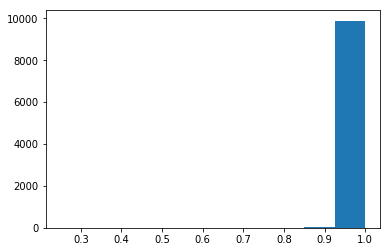

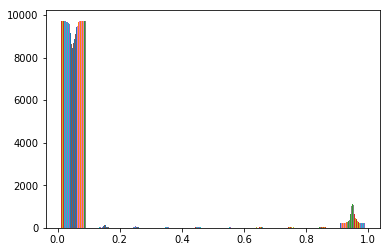

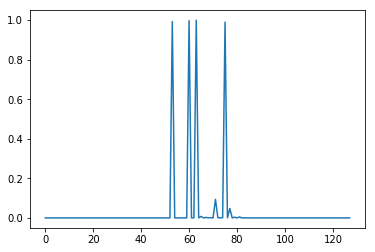

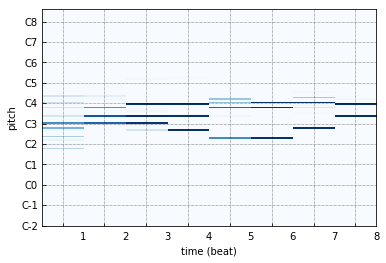

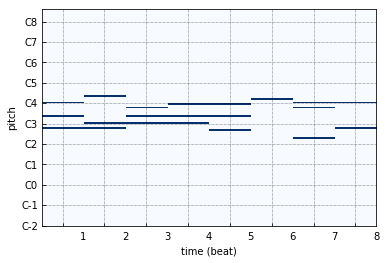

...

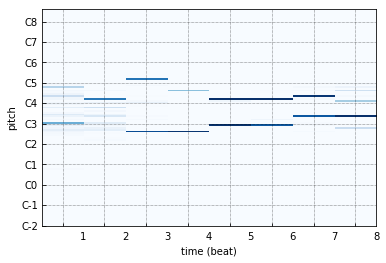

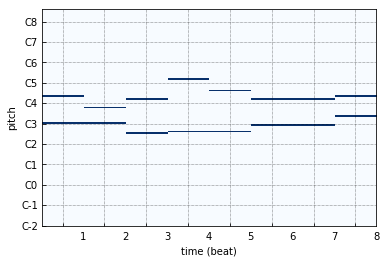

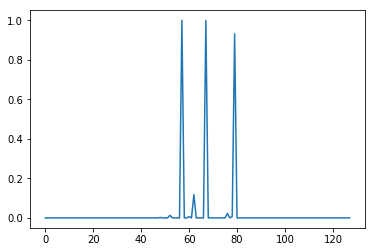

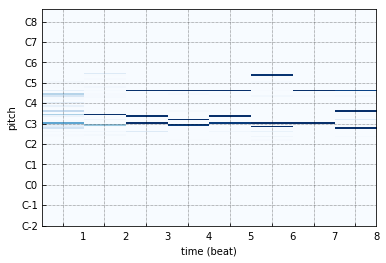

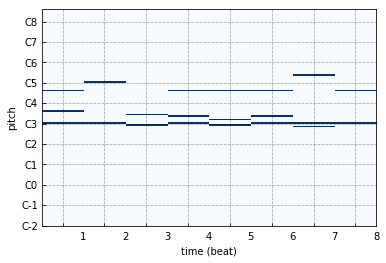

In [58]:
a = model.predict(train_xs, verbose=True)
maxes = [np.max(c) for c in a]
plt.hist(maxes)
plt.show()
plt.hist(a[:,-1])
plt.show()
b = np.max(a[1][-1])
plt.plot(a[1][-1])
plt.show()
prep.visualize_piano_roll(a[0].T, fs=1)
prep.visualize_piano_roll(train_xs[0].T, fs=1)
plt.plot(a[100][-1])
plt.show()
prep.visualize_piano_roll(a[100].T, fs=1)
prep.visualize_piano_roll(train_xs[100].T, fs=1)
plt.plot(a[200][-1])
plt.show()
prep.visualize_piano_roll(a[200].T, fs=1)
prep.visualize_piano_roll(train_xs[200].T, fs=1)

In [65]:
# For y_t, ..., y_t+sequence_length, predict y_t+sequence_length+1
# Let the new sequence be y_t, ..., y_t+sequence_length+1
# Generate until EOF reached, or limit

def make_song_from_predict(model, initial_data, limit):
    song = []
    keep_producing = True
    prev_data = initial_data
    while keep_producing and len(song) < limit:
        predictions = model.predict(np.array([prev_data]))[0]
        labels = np.zeros(128)
        labels[predictions[-1]/np.max(predictions[-1])>0.5] = 1 
        # Threshold to consider the key as active, binarized based on this
        keep_producing = np.sum(labels) != len(labels)
        song.append(labels)
        prev_data = np.append(prev_data[1:], [labels], 0)
    return np.array(song)

initial_step = 750
steps = 10
song1 = make_song_from_predict(model, train_xs[initial_step], sequence_length*steps)

prep.embed_play_v1(song1.T, fs=1)


[0. 0. 0. 1.]
mz


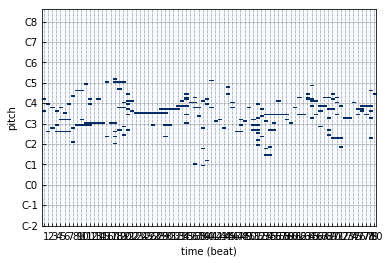

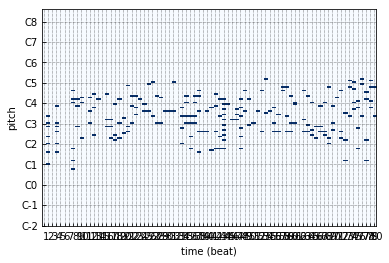

In [66]:
actual = train_xs[initial_step+1]
print(train_composers[initial_step])
print(int_to_name[list(train_composers[initial_step]).index(1)])
for i in range(1, steps):
    actual = np.append(actual, train_xs[initial_step+1+i], axis=0)
actual = actual.T
prep.visualize_piano_roll(song1.T, fs=1)

prep.visualize_piano_roll(actual, fs=1)
prep.embed_play_v1(actual, fs=1)

In [82]:
# Specialist takes input one-hot encoding of composer (length 4)
specialist_input = Input(shape=(composer_encoding_len,))
x = Dense(64)(specialist_input)
specialist_output_c = Dense(num_keys, activation="relu")(x)
specialist_output_h = Dense(num_keys, activation="relu")(x)
specialist_output_h = Dropout(1.0)(specialist_output_h)
inputs = Input(shape=(sequence_length, num_keys))

lstm1 = LSTM(num_keys,
               activation='relu',
               return_sequences=True,
               name="lstm1")

# Seed the hidden state using the specialist
lstm1_outputs = lstm1(inputs, initial_state=[specialist_output_h, specialist_output_c])

normalized1 = BatchNormalization()(lstm1_outputs)
dense1 = Dense(num_keys, activation="relu", name="dense1")(normalized1)

lstm2 = LSTM(num_keys,
               activation='relu',
               return_sequences=True, name="lstm2")(dense1)

normalized2 = BatchNormalization()(lstm2)
outputs = TimeDistributed(Dense(num_keys, activation="sigmoid", name="outputs"))(normalized2) # Sigmoid keeps the probabilities independent of each other, while softmax does not!

specialist_model = Model([inputs, specialist_input], outputs)


adam = Adam(lr=0.0001, amsgrad=True) 


specialist_model.load_weights("./models/fs1_8_offset1_generalist_weights.h5", by_name=True)

specialist_model.compile(loss='binary_crossentropy',
              optimizer=adam,
              metrics=['categorical_accuracy'])

# Can actually "freeze" keras layers as to not update, to train only specialist layers.
inputs.trainable = False
#lstm1.trianable = False
#normalized1.trainable = False
#dense1.trainable = False
#lstm2.trainable = False
#normalized2.trainable = False
#outputs.trainable = False


print(specialist_model.summary())

specialist_model.fit([train_xs, train_composers], train_ys,
          epochs=150, # Train harder more for more things was too bad train man :(
          batch_size=32,
          shuffle=True, # shuffle here but not when constructing set to be able to validate later on :)
          #callbacks=[tensorboard, early_stop],
          validation_data=([test_xs, test_composers], test_ys),
          )

specialist_model.save("./models/fs1_8_offset1_generalist_specialist.h5")

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_42 (InputLayer)           (None, 4)            0                                            
__________________________________________________________________________________________________
dense_58 (Dense)                (None, 64)           320         input_42[0][0]                   
__________________________________________________________________________________________________
dense_60 (Dense)                (None, 128)          8320        dense_58[0][0]                   
__________________________________________________________________________________________________
input_43 (InputLayer)           (None, 8, 128)       0                                            
__________________________________________________________________________________________________
dropout_12

Epoch 31/150
9961/9961 [==============================] - 9s 864us/step - loss: 0.0512 - categorical_accuracy: 0.2018 - val_loss: 0.0546 - val_categorical_accuracy: 0.2088
Epoch 32/150
9961/9961 [==============================] - 9s 867us/step - loss: 0.0504 - categorical_accuracy: 0.2070 - val_loss: 0.0536 - val_categorical_accuracy: 0.2134
Epoch 33/150
9961/9961 [==============================] - 9s 865us/step - loss: 0.0496 - categorical_accuracy: 0.2117 - val_loss: 0.0529 - val_categorical_accuracy: 0.2165
Epoch 34/150
9961/9961 [==============================] - 9s 869us/step - loss: 0.0488 - categorical_accuracy: 0.2138 - val_loss: 0.0524 - val_categorical_accuracy: 0.2203
Epoch 35/150
9961/9961 [==============================] - 9s 869us/step - loss: 0.0482 - categorical_accuracy: 0.2173 - val_loss: 0.0515 - val_categorical_accuracy: 0.2249
Epoch 36/150
9961/9961 [==============================] - 9s 868us/step - loss: 0.0475 - categorical_accuracy: 0.2220 - val_loss: 0.0508 - v

9961/9961 [==============================] - 9s 870us/step - loss: 0.0305 - categorical_accuracy: 0.3094 - val_loss: 0.0352 - val_categorical_accuracy: 0.3137
Epoch 79/150
9961/9961 [==============================] - 9s 874us/step - loss: 0.0303 - categorical_accuracy: 0.3083 - val_loss: 0.0350 - val_categorical_accuracy: 0.3168
Epoch 80/150
9961/9961 [==============================] - 9s 869us/step - loss: 0.0301 - categorical_accuracy: 0.3099 - val_loss: 0.0347 - val_categorical_accuracy: 0.3152
Epoch 81/150
9961/9961 [==============================] - 9s 866us/step - loss: 0.0301 - categorical_accuracy: 0.3090 - val_loss: 0.0348 - val_categorical_accuracy: 0.3166
Epoch 82/150
9961/9961 [==============================] - 9s 884us/step - loss: 0.0298 - categorical_accuracy: 0.3116 - val_loss: 0.0345 - val_categorical_accuracy: 0.3164
Epoch 83/150
9961/9961 [==============================] - 9s 873us/step - loss: 0.0294 - categorical_accuracy: 0.3127 - val_loss: 0.0342 - val_categorica

9961/9961 [==============================] - 9s 889us/step - loss: 0.0238 - categorical_accuracy: 0.3378 - val_loss: 0.0300 - val_categorical_accuracy: 0.3422
Epoch 126/150
9961/9961 [==============================] - 9s 950us/step - loss: 0.0238 - categorical_accuracy: 0.3378 - val_loss: 0.0297 - val_categorical_accuracy: 0.3401
Epoch 127/150
9961/9961 [==============================] - 10s 1ms/step - loss: 0.0238 - categorical_accuracy: 0.3378 - val_loss: 0.0297 - val_categorical_accuracy: 0.3421
Epoch 128/150
9961/9961 [==============================] - 10s 975us/step - loss: 0.0236 - categorical_accuracy: 0.3378 - val_loss: 0.0296 - val_categorical_accuracy: 0.3423
Epoch 129/150
9961/9961 [==============================] - 10s 980us/step - loss: 0.0234 - categorical_accuracy: 0.3394 - val_loss: 0.0295 - val_categorical_accuracy: 0.3426
Epoch 130/150
9961/9961 [==============================] - 10s 1ms/step - loss: 0.0234 - categorical_accuracy: 0.3393 - val_loss: 0.0296 - val_categ

c:\users\hanak\dev\composer\venv\lib\site-packages\keras\engine\network.py:877: UserWarning: Layer lstm1 was passed non-serializable keyword arguments: {'initial_state': [<tf.Tensor 'dropout_12/Identity:0' shape=(?, 128) dtype=float32>, <tf.Tensor 'dense_59/Relu:0' shape=(?, 128) dtype=float32>]}. They will not be included in the serialized model (and thus will be missing at deserialization time).
  '. They will not be included '


In [89]:
def make_song_from_predict(model, initial_data, composer, limit):
    song = []
    keep_producing = True
    prev_data = initial_data
    while keep_producing and len(song) < limit:
        predictions = model.predict([np.array([prev_data]), composer])[0]
        labels = np.zeros(128)
        labels[predictions[-1]/np.max(predictions[-1])>0.75] = 1 # Threshold to consider the key as active, binarized based on this
        keep_producing = np.sum(labels) != len(labels)
        song.append(labels)
        prev_data = np.append(prev_data[1:], [labels], 0)
    return np.array(song)

initial_step = 1
steps = 10
song1 = make_song_from_predict(specialist_model, train_xs[initial_step], np.array([[1.0, 0.0, 0.0, 0.0]]), sequence_length*steps)
song2 = make_song_from_predict(specialist_model, train_xs[initial_step], np.array([[0.0, 1.0, 0.0, 0.0]]), sequence_length*steps)
song3 = make_song_from_predict(specialist_model, train_xs[initial_step], np.array([[0.0, 0.0, 1.0, 0.0]]), sequence_length*steps)
song4 = make_song_from_predict(specialist_model, train_xs[initial_step], np.array([[0.0, 0.0, 0.0, 1.0]]), sequence_length*steps)
prep.embed_play_v1(song1.T, fs=1)

bach


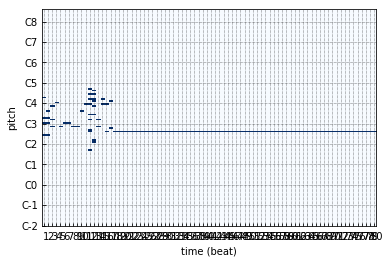

debussy


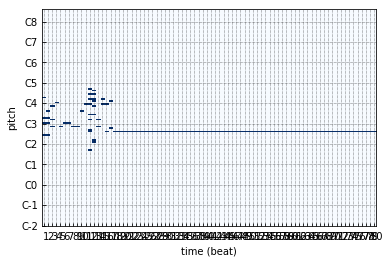

brahms


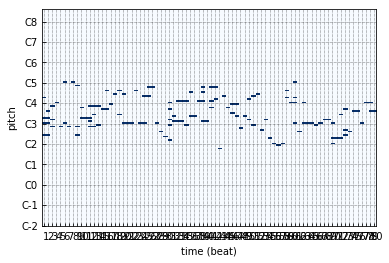

mz


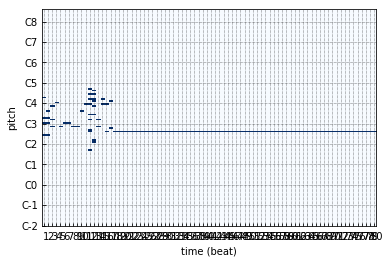

[0. 0. 0. 1.]
mz


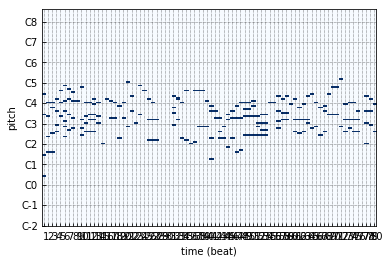

In [90]:
actual = train_xs[initial_step+1]
for i in range(1, steps):
    actual = np.append(actual, train_xs[initial_step+1+i], axis=0)
actual = actual.T
print(int_to_name[0])
prep.visualize_piano_roll(song1.T, fs=1)
print(int_to_name[1])
prep.visualize_piano_roll(song2.T, fs=1)
print(int_to_name[2])
prep.visualize_piano_roll(song3.T, fs=1)
print(int_to_name[3])
prep.visualize_piano_roll(song4.T, fs=1)
print(train_composers[initial_step])
print(int_to_name[list(train_composers[initial_step]).index(1)])
prep.visualize_piano_roll(actual, fs=1)
prep.embed_play_v1(actual, fs=1)